In [37]:
import os
from glob import glob
from warnings import simplefilter

import pandas as pd
from IPython.display import Image, display

In [38]:
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=UserWarning)

#### Load utility functions

In [ ]:
from src.utilities.aircraft.plotting.draw_bounding_boxes import draw_bounding_boxes

#### Configure path parameters and read data files

In [18]:
ROOT_DIR = os.path.abspath(os.path.join(os.getcwd(), *['..'] * 4)) 
IMAGES_DIR = os.path.join(ROOT_DIR, "data", "aircraft", "images")

In [22]:
images = glob(os.path.join(IMAGES_DIR, "*.jpg"))  # get all files with the .jpg extension
labels_fp = os.path.join(ROOT_DIR, "data", "aircraft", "annotations.csv")

In [23]:
df_labels = pd.read_csv(labels_fp, converters={'geometry':lambda x:list(eval(x))})  # parse the list of tuples from string literal

#### Sample an image from the dataset

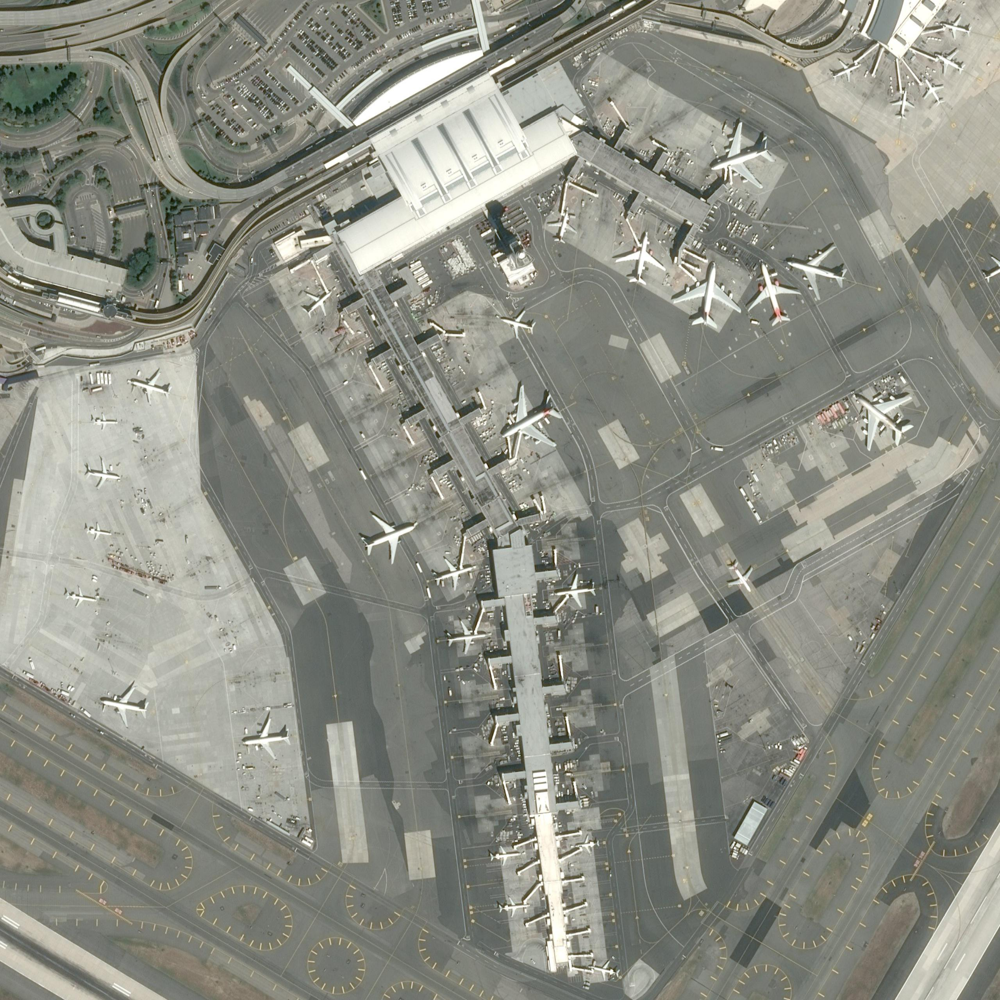

In [24]:
sampled_image_fp = sorted(images)[0]  # we sort the images and print the first only for reproducibility
display(Image(sampled_image_fp))

The `aircraft` dataset contains high-resolution satellite images of airports. Each image has some number of aircraft (typically non-overlapping and fully in frame). Aircraft very in size, shape, and color. The dataset is labeled with bounding boxes, which describe where the aircraft are in each labeled image.

Notice in the sample above that the aircraft may be taxiing on a runway, near a hangar, waiting at a terminal, and pointed in any direction. As a viewer, it is relatively easy to identify these aircraft. However, developing programmatic rules is quite challenging. Using naive (pixel-valued) image similarity scores for patches of the full image could work if all aircraft were identical in their size, orientation, make, and model. Even after applying rotation and scaling transforms, aircraft of different shapes and colors would be difficult to identify.

One common approach to this family of problems is in "learning" the features which the aircraft share. This is analogous to the way we might identify the aircraft in an image as viewers. We might use heuristics like "aircraft have a long body, two mirrored wings, a tail, and a pointed nose" in order to distinguish an airplane from a shipping container, bus, or airport terminal.

Learning these features as feature maps allows us to apply detection models which outperform traditional image similarity models.

#### An overview of the `aircraft` labels

While the dataset is called `aircraft` it is specifically curated for airplane detection. As we saw in the same above, some of these airplanes might not be fully captured in the frame of the image.

We can examine the full set of classes that a label can take by analyzing the `pd.DataFrame` object that stores the labels and associated metadata for the images in our dataset.

In [25]:
df_labels["class"].unique()

array(['Airplane', 'Truncated_airplane'], dtype=object)

If we examine the filepath that we selected to print above, we can see that it ends in a filename which includes a `UUID`. This identifier is useful for obtaining the labels that map to the image from the `DataFrame`.

In [26]:
sampled_image_fp

'/home/jupyter/work/data/aircraft/images/014de911-7810-4f7d-8967-3e5402209f4a.jpg'

In [27]:
df_labels.loc[df_labels["image_id"] == sampled_image_fp.split("/")[-1]]["geometry"].values[0]  # we split on the "/" character and take the last part

[(2404, 35), (2493, 35), (2493, 102), (2404, 102), (2404, 35)]

In the list above, we have many labeled airplanes with one truncated airplane. We can plot the bounding boxes for all the airplane (and the truncated airplane) to get a sense of the ground-truth data we have access to.

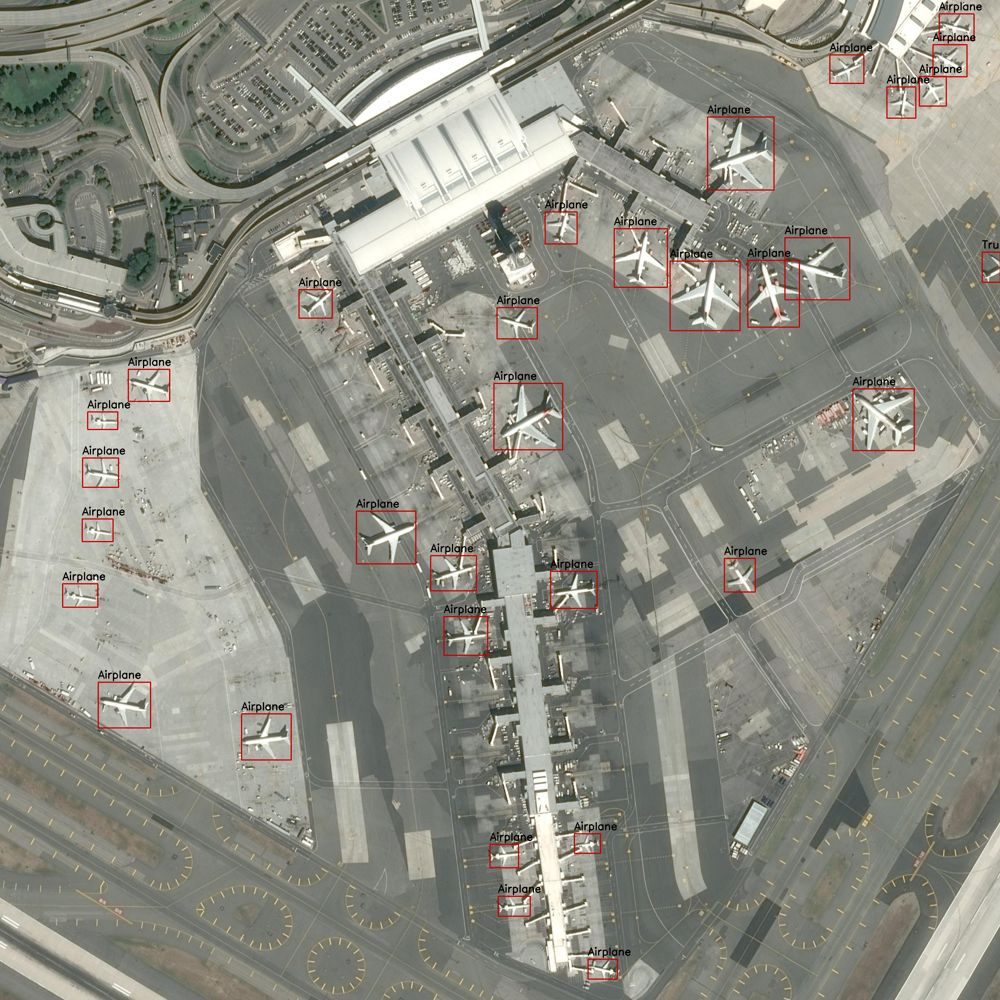

In [28]:
draw_bounding_boxes(sampled_image_fp, df_labels)

During training, the neural network analyzes the image pixels within the bounding boxes to learn the visual patterns and characteristics that define an aircraft. These patterns are encoded as features in the network's layers (feature maps). Features are learned representations of characteristics like edges, corners, shapes, and even more complex aspects like the wings, tail, or fuselage of an aircraft. By learning from the labeled bounding boxes, the network develops the ability to not only recognize the features of an aircraft but also to accurately localize it within an image.

#### Convolutional Neural Networks

At its core, a Convolutional Neural Network (CNN) is designed to automatically and adaptively learn spatial hierarchies of features. This is achieved through the application of convolutional layers, which employ learnable filters to scan the input data (often an image) and produce feature maps. Each filter in a convolutional layer acts as a pattern detector, identifying specific visual features like edges, textures, or more complex shapes. The resulting feature map highlights the presence and location of these features in the input, creating a representation that emphasizes the spatial relationships between them. As we progress through deeper layers of the CNN, the filters become more sophisticated, capturing increasingly abstract and high-level features. This hierarchical feature extraction process allows CNNs to effectively recognize objects and patterns in images.


#### Feature maps

A feature map in a CNN is essentially a multi-dimensional array (tensor) that results from applying a convolutional filter to the input data. This filter, represented as a small matrix of weights, slides across the input, performing element-wise multiplications and summations to produce a single value in the feature map. This process is repeated for each position in the input, generating a map that highlights the areas where the filter's pattern is detected. The dimensions of the feature map depend on the size of the input, the filter size, the stride (how much the filter moves in each step), and the padding (adding extra pixels around the input). Importantly, each filter in a convolutional layer produces its own feature map, and a layer typically has multiple filters, resulting in a stack of feature maps that capture different aspects of the input.

#### Importance for Region Proposals

In object detection tasks, the goal is not only to classify objects but also to localize them within an image by predicting bounding boxes. Region proposal methods aim to generate potential regions of interest that might contain objects. Feature maps play a crucial role in this process by providing a rich, spatially-aware representation of the image's content. The deeper layers of a CNN, with their high-level feature maps, can identify abstract object parts or patterns that are indicative of the presence of an object. These feature maps can be used to guide the generation of region proposals, focusing the search for objects on areas with high activations for relevant features. Techniques like Region Proposal Networks (RPNs) directly utilize feature maps to predict objectness scores and bounding box coordinates, enabling efficient and accurate object localization.

Rather than learning these feature maps directly, we can examined the feature maps from a pre-trained model, which leverages CNN modules to learn features relevant to object detection.

In [29]:
import torch
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from PIL import Image as PILImage

For demonstration, we can select the "[Faster R-CNN with ResNet-50 Backbone and Feature Pyramid Network (FPN)](https://arxiv.org/pdf/1506.01497)" model from the `torchvision` package.

Faster R-CNN builds upon the foundations of Convolutional Neural Networks (CNNs) for object detection, combining the strengths of region proposal networks and deep feature extraction. At its heart lies a backbone CNN, such as ResNet-50, responsible for generating a hierarchy of feature maps that capture progressively more abstract visual information from an input image. These feature maps serve as the foundation for subsequent object detection stages. The Region Proposal Network (RPN) leverages these feature maps to propose potential regions of interest (bounding boxes) that are likely to contain objects. These proposals are then refined and classified by the Region of Interest (RoI) pooling layer, which extracts fixed-size feature vectors from the proposed regions. Finally, a classifier head predicts the object categories and refines the bounding box coordinates for each proposal, enabling accurate object detection and localization.

#### Technical Implementation:

The Faster R-CNN architecture with a ResNet-50 backbone and Feature Pyramid Network (FPN) employs several key components. The ResNet-50 backbone acts as a powerful feature extractor, efficiently processing the input image through a series of convolutional layers with residual connections. The FPN enhances the feature maps by creating a pyramid of feature maps at multiple scales, allowing the model to detect objects of various sizes. The RPN slides over these feature maps, generating anchor boxes at different scales and aspect ratios and predicting objectness scores and bounding box offsets for each anchor. The RoI pooling layer then extracts features from the proposed regions, ensuring a fixed-size representation for the subsequent classifier head. Finally, the classifier head, typically consisting of fully connected layers, predicts the object class and refines the bounding box coordinates, providing the final object detections.

#### Feature Extraction for Region Proposals

In the Faster R-CNN framework, the region proposal mechanism is tightly integrated with the feature extraction process. The RPN directly leverages the multi-scale feature maps generated by the FPN, allowing it to effectively identify potential object locations across a wide range of scales. The high-level feature maps from the deeper layers of the ResNet-50 backbone capture rich semantic information, enabling the RPN to discriminate between object-like regions and background. This synergy between feature extraction and region proposal generation leads to a significant improvement in object detection accuracy and efficiency, making Faster R-CNN a cornerstone of modern object detection systems.

#### The Pre-trained Model

In addition to the model architecture, we load the weights and biases for the RCNN ResNet FPN model trained on [the COCO dataset](https://cocodataset.org/#home). The Faster R-CNN model we're using, while powerful, has been pre-trained on the COCO dataset, which focuses on everyday objects rather than specialized domains like aircraft recognition at airports. The model's ability to pinpoint aircraft in our context is limited. As a result, the predictions and feature maps we explore are notional, but interesting to examine none the less. Visualizing the activations of the model's feature maps offers a glimpse into the hierarchical representations it has learned using other data.


In [30]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()  # Set the model to evaluation mode

/opt/conda/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /home/jovyan/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [01:37<00:00, 1.72MB/s] 


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In order to use this pre-trained model in inference (generating proposed bounding boxes for a given, unlabled input image), we must first transform the image to a `torch.Tensor` with the appropriate characteristics.

In [31]:
img = PILImage.open(sampled_image_fp).convert("RGB")

# Define transformations
transform = transforms.Compose([
    transforms.ToTensor(),  # Convert to PyTorch tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize to ImageNet stats
])

# Apply transformations to the image
img_tensor = transform(img)
img_tensor = img_tensor.unsqueeze(0)

Now that we have the appropriate tensor representation of our image, we can use the pre-trained model to generate the predicted bounding boxes. As the input image passes through the convolutional layers of the backbone, it undergoes a series of transformations, resulting in a hierarchy of feature maps. These feature maps represent the learned features at different levels of abstraction, from low-level edges and textures in the early layers to more complex object parts and semantic information in the deeper layers. By obtaining these feature maps, we gain insights into the internal representations that the model has learned to identify and utilize for object detection.

In [32]:
# Get the model's predictions
with torch.no_grad():
    predictions = model(img_tensor)

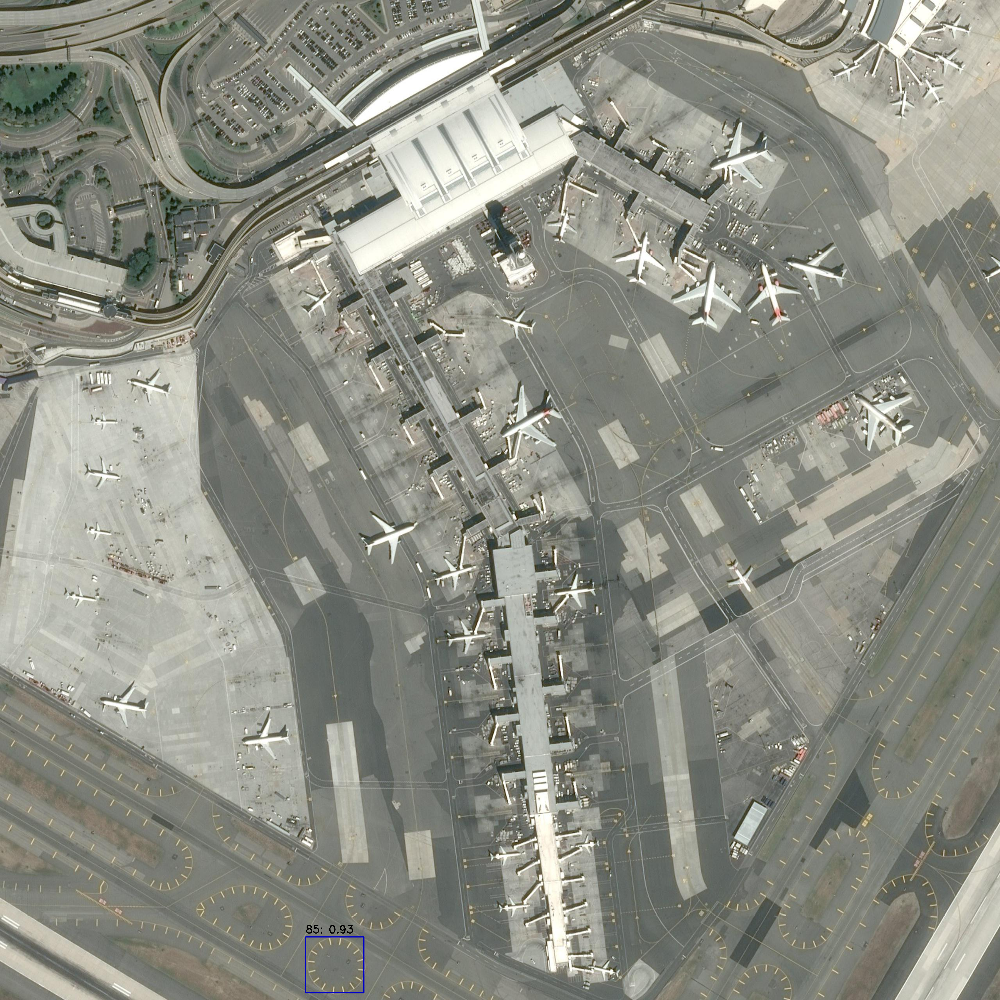

In [33]:
draw_bounding_boxes(sampled_image_fp, prediction=predictions[0])  # we generate batched predictions, so we take the first element

As expected, the model with COCO pre-trained weights failed to identify the aircraft from above in our sampled airport image. Interestingly, we have a bounding box with a high objectness score of class `85`. We can determine what object the model identified in the image by examining the metadata from the `torchvision` package.

In [34]:
model_categories = torchvision.models.detection.FasterRCNN_ResNet50_FPN_Weights.DEFAULT.meta["categories"]
model_categories[85]

'clock'

It does look like a clock! In this case, the feature representation of this patch in our image are similar to those of the clocks in the model's training data.

In [35]:
# Obtain the feature maps
features = model.backbone(img_tensor)

#### Learned Feature Map Visualization

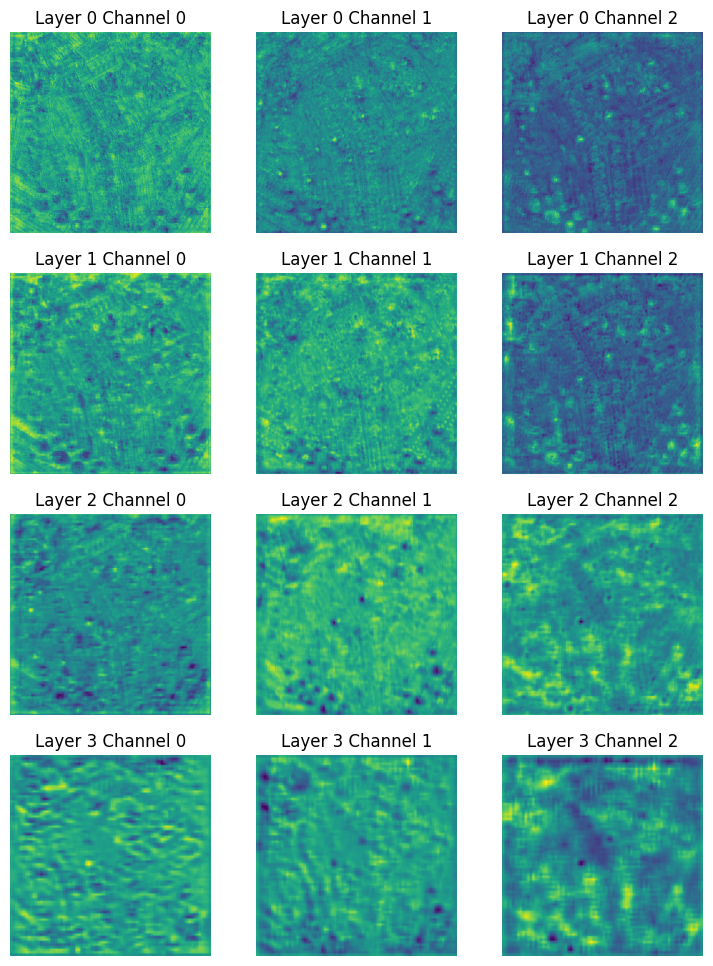

<Figure size 640x480 with 0 Axes>

In [36]:
layers = ['0', '1', '2', '3']  # these are the keys for the feature maps
channels = [0, 1, 2]

# Create the figure and axes
fig, axs = plt.subplots(len(layers), len(channels), figsize=(3*len(channels), 3*len(layers)))
plt.close(fig)  # Don't show the figure yet

for layer_index, l in enumerate(layers):
    for channel_index, c in enumerate(channels):
        feature_map = features[l][0][c].squeeze(0)

        # Normalize
        normalized_feature_map = (feature_map - feature_map.min()) / (feature_map.max() - feature_map.min())

        # Convert to numpy array
        normalized_feature_map_np = normalized_feature_map.detach().cpu().numpy()

        # Plot with origin at the top-left
        axs[layer_index, channel_index].imshow(normalized_feature_map_np, cmap='viridis', origin='upper')
        axs[layer_index, channel_index].axis('off')
        axs[layer_index, channel_index].set_title(f'Layer {l} Channel {c}')

# Display the figure after all feature maps are plotted
plt.tight_layout()
display(fig)

#### Low-level Features

The initial layers of backbone model show strong activations in regions corresponding to edges and corners in the image. These can be hard to intuit from the airport-level image we passed through the model, but the outlines of prominent structures and large-scale geometric features. Traditionally, early layers in a multi-layer CNN also capture things like texture and gradients within an image. These large scale patterns, coupled with the learned edge activations, are critical in learning high level structure from data.


#### Mid-Level Features

The middle layers of our backbone attempt to identify basic objects within our image. These objects are typically learned combinations of the edges and textures learned in lower layers. As an example, we might differentiate between a square of grass and a square of tarmac by their texture and edges. In layer `1` and `2` above, you might be able to see what looks like the structure of the airport's terminals and runway. If that image doesn't jump out at you, don't worry, the feature maps are much more useful for the regional-proposal network than they are to a viewer, and were trained for general object detection rather than aircraft detection on satellite images.

#### High-Level Features

The final layers of our backbone are typically useful for identifying higher-level, more abstract features such as an object in context (an airplane at a terminal as opposed to an airplane on the tarmac, or a private jet as opposed to a tanker). In our example, these features are less meaningful given the fact that the model was not trained using data from the same domain. In general, these feature maps are often hard to interpret visually, but are meaningful when developing the "objectness score" in the RPN.

#### The use of Feature Maps by the RPN

The RPN analyzes the feature maps, especially those from the deeper layers, to predict the likelihood of an object being present at different locations in the image. For each object candidate the RPN generates an anchor box and a class prediction objectness score. In the aircraft dataset, we have one main class of interest, namely aircraft, but in other common computer vision tasks, there can be tens to thousands of different classes for which we predict bounding boxes.

These candidate bounding boxes and objectness scores inform the final predictions for the model.